In [1]:
import os

import numpy as np
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import plotnine
from plotnine import *

import anndata as ad
import scanpy as sc
import cell2location
from cell2location.utils import select_slide
from cell2location.utils.filtering import filter_genes
from cell2location.plt import plot_spatial
from cell2location.models import RegressionModel, Cell2location
import scvi
import pyro.optim

%matplotlib inline

import sys
sys.path.insert(0, "..")
from plot_settings import *

Global seed set to 0


In [2]:
results_folder = "cell2location_human_ffpe_regions"
ref_run_name = os.path.join(results_folder, "reference_signatures")
run_name = os.path.join(results_folder, "cell2location_map")

In [3]:
adata_ref = ad.read_h5ad("../human/adatas/3.4.h5ad")

In [11]:
RegressionModel.setup_anndata(
    adata=adata_ref, labels_key="segmentation_labels", layer="counts"
)

mod = RegressionModel(adata_ref)
mod.view_anndata_setup()

/home/kats/.local/lib/python3.10/site-packages/scvi/data/_utils.py:156: UserWarning: Category 8 in adata.obs['_scvi_labels'] has fewer than 3 cells. Models may not train properly.


Anndata setup with scvi-tools version 0.16.2.

Setup via `RegressionModel.setup_anndata` with arguments:

{
│   'layer': 'counts',
│   'batch_key': None,
│   'labels_key': 'segmentation_labels',
│   'categorical_covariate_keys': None,
│   'continuous_covariate_keys': None
}

         Summary Statistics         
┏━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━┓
┃     Summary Stat Key     ┃ Value ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━┩
│         n_cells          │ 3983  │
│          n_vars          │ 11182 │
│         n_batch          │   1   │
│         n_labels         │  12   │
│ n_extra_categorical_covs │   0   │
│ n_extra_continuous_covs  │   0   │
└──────────────────────────┴───────┘

               Data Registry                
┏━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Registry Key ┃    scvi-tools Location    ┃
┡━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│      X       │  adata.layers['counts']   │
│    batch     │ adata.obs['_scvi_batch']  │
│    labels    │ adata.obs['_scvi_labels'] │
│    ind_x     │   adata.obs['_indices']   │
└──────────────┴───────────────────────────┘

                     batch State Registry                      
┏━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃     Source Location      ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['_scvi_batch'] │     0      │          0          │
└──────────────────────────┴────────────┴─────────────────────┘

                         labels State Registry                         
┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃         Source Location          ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['segmentation_labels'] │     0      │          0          │
│                                  │     1      │          1          │
│                                  │     2      │          2          │
│                                  │     3      │          3          │
│                                  │     4      │          4          │
│                                  │     5      │          5          │
│                                  │     6      │          6          │
│                                  │     7      │          7          │
│                                  │     8      │          8          │
│                                  │     9      │          9          │
│                                  │     10     │         10          │
│                                  │     11     │         11          │
└──────────────────────────────────┴────────────┴─────────────────────┘

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
/home/kats/.local/lib/python3.10/site-packages/pytorch_lightning/trainer/configuration_validator.py:120: UserWarning: You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]
/home/kats/.local/lib/python3.10/site-packages/pytorch_lightning/trainer/data_loading.py:432: UserWarning: The number of training samples (1) is smaller than the logging interval Trainer(log_every_n_steps=10). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Epoch 30000/30000: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 30000/30000 [35:19<00:00, 14.15it/s, v_num=1, elbo_train=6.29e+7]


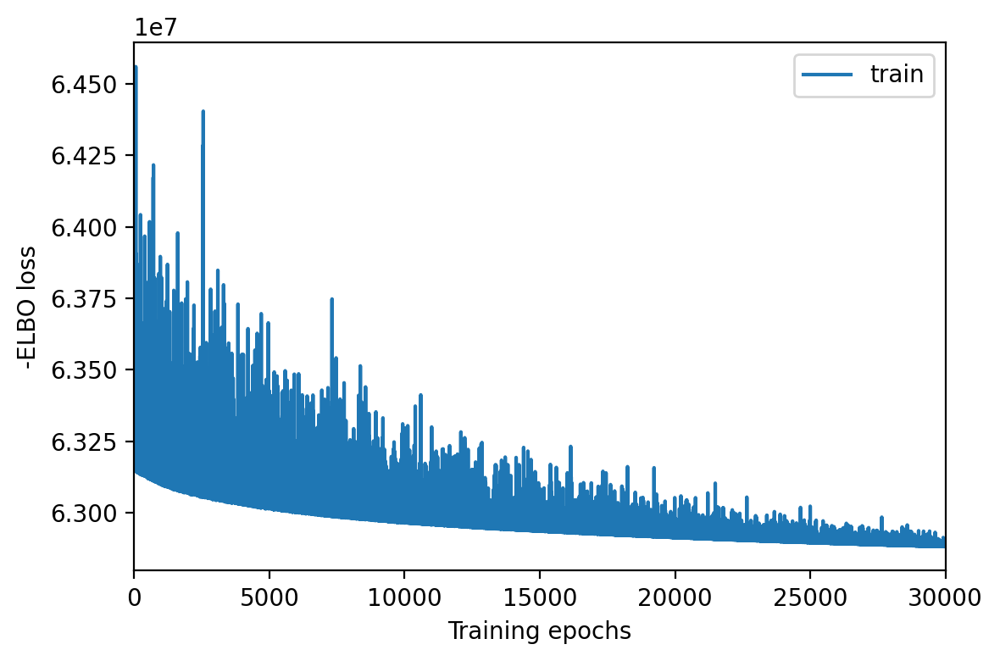

In [12]:
mod.train(max_epochs=30000, batch_size=None, train_size=1, lr=0.0001, use_gpu=True)
with mpl.rc_context({"figure.dpi": 200}):
    mod.plot_history(20)

In [13]:
mod.save(ref_run_name, overwrite=True)

In [14]:
adata_ref = mod.export_posterior(
    adata_ref, sample_kwargs={"num_samples": 10000, "batch_size": 5000, "use_gpu": True}
)
adata_ref.write(
    os.path.join(ref_run_name, "sc.h5ad"), compression="gzip", compression_opts=9
)

Sampling global variables, sample: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9999/9999 [01:32<00:00, 108.00it/s]


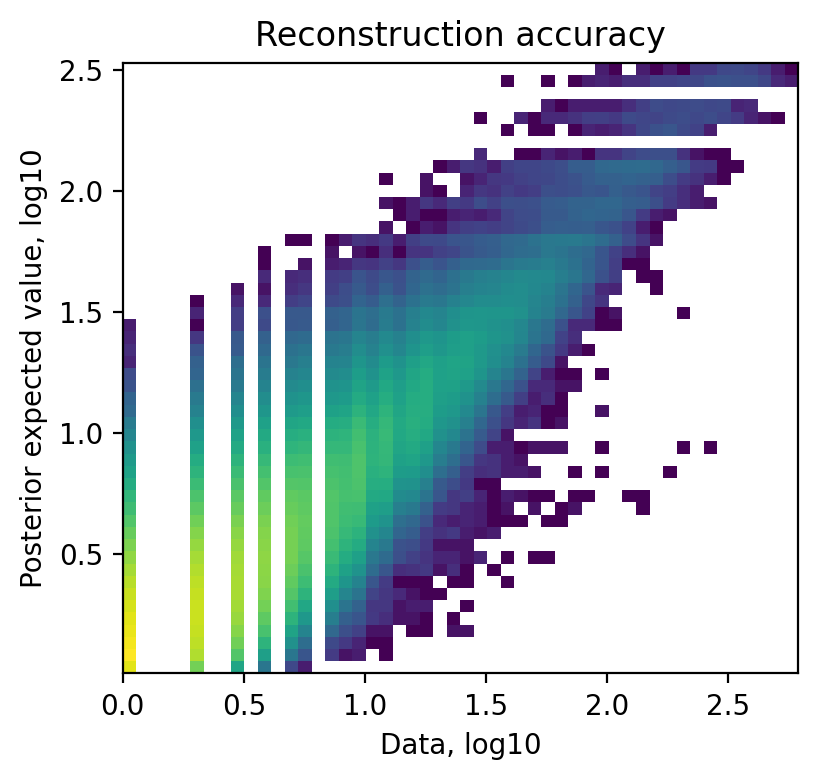

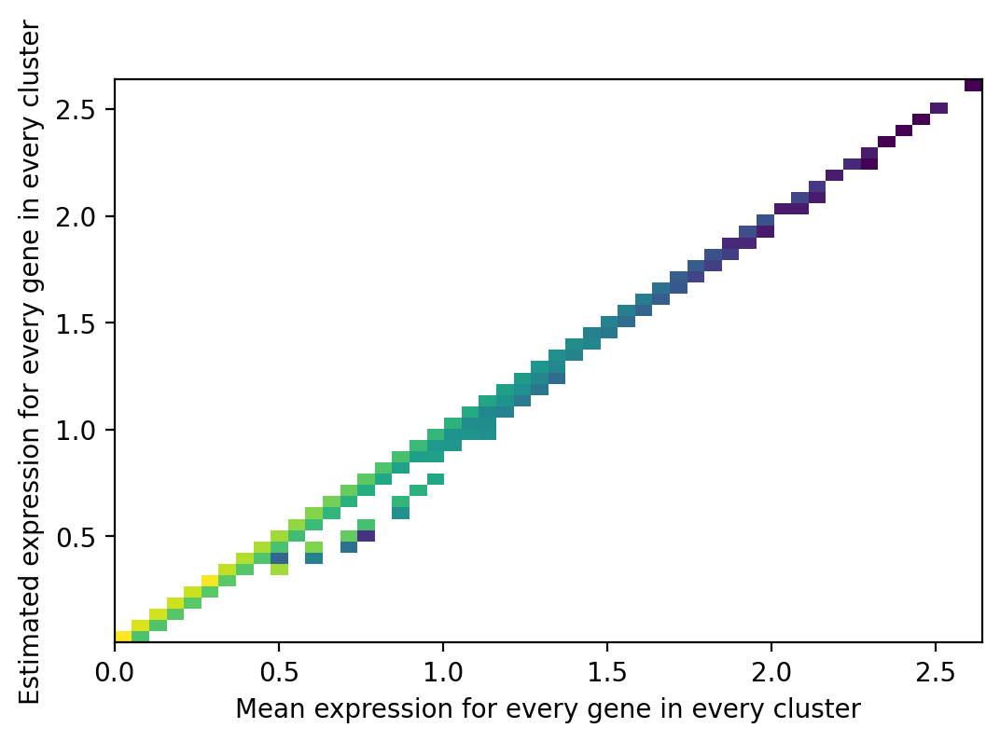

In [15]:
with mpl.rc_context({"figure.dpi": 200}):
    mod.plot_QC()

In [4]:
adata_ref = ad.read_h5ad(os.path.join(ref_run_name, "sc.h5ad"))

In [17]:
adatas = {}
for f in os.scandir("adatas/human/"):
    adatas[os.path.splitext(f.name)[0]] = ad.read_h5ad(f.path)
del adatas["sample1.1"]

In [18]:
adata_vis = ad.concat(
    adatas, label="sample", merge="same", uns_merge="unique", index_unique="_"
)
adata_vis.var["mt"] = adata_vis.var_names.str.startswith("MT-")

In [19]:
adata_vis = adata_vis[:, ~adata_vis.var["mt"].to_numpy()]

inf_aver = adata_ref.varm["means_per_cluster_mu_fg"][
    [f"means_per_cluster_mu_fg_{i}" for i in adata_ref.uns["mod"]["factor_names"]]
]
inf_aver.columns = adata_ref.uns["mod"]["factor_names"]

intersect = adata_ref.var_names.intersection(adata_vis.var_names)

adata_vis = adata_vis[:, intersect].copy()
inf_aver = inf_aver.loc[intersect, :]
Cell2location.setup_anndata(adata_vis, batch_key="sample", layer="counts")

In [20]:
mod = Cell2location(
    adata_vis, cell_state_df=inf_aver, N_cells_per_location=30, detection_alpha=200
)
mod.view_anndata_setup()

Anndata setup with scvi-tools version 0.16.2.

Setup via `Cell2location.setup_anndata` with arguments:

{
│   'layer': 'counts',
│   'batch_key': 'sample',
│   'labels_key': None,
│   'categorical_covariate_keys': None,
│   'continuous_covariate_keys': None
}

         Summary Statistics         
┏━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━┓
┃     Summary Stat Key     ┃ Value ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━┩
│         n_cells          │ 10168 │
│          n_vars          │ 5221  │
│         n_batch          │  11   │
│         n_labels         │   1   │
│ n_extra_categorical_covs │   0   │
│ n_extra_continuous_covs  │   0   │
└──────────────────────────┴───────┘

               Data Registry                
┏━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Registry Key ┃    scvi-tools Location    ┃
┡━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│      X       │  adata.layers['counts']   │
│    batch     │ adata.obs['_scvi_batch']  │
│    labels    │ adata.obs['_scvi_labels'] │
│    ind_x     │   adata.obs['_indices']   │
└──────────────┴───────────────────────────┘

                   batch State Registry                   
┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃   Source Location   ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['sample'] │ sample1.3  │          0          │
│                     │ sample3.2  │          1          │
│                     │ sample2.4  │          2          │
│                     │ sample2.1  │          3          │
│                     │ sample1.4  │          4          │
│                     │ sample1.2  │          5          │
│                     │ sample2.3  │          6          │
│                     │ sample3.1  │          7          │
│                     │ sample3.4  │          8          │
│                     │ sample3.3  │          9          │
│                     │ sample2.2  │         10          │
└─────────────────────┴────────────┴─────────────────────┘

                     labels State Registry                      
┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃      Source Location      ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['_scvi_labels'] │     0      │          0          │
└───────────────────────────┴────────────┴─────────────────────┘

In [21]:
from pyro.optim.optim import is_scheduler


class LRDTrainingPlan(scvi.train.PyroTrainingPlan):
    def training_epoch_end(self, outputs):
        super().training_epoch_end(outputs)
        if is_scheduler(self.optim):
            self.optim.step()

In [22]:
from pyro.optim import LinearLR
from torch.optim import Adam

start_lr = 0.002
end_lr = 0.0001
epochs = 40000
mod.train(
    max_epochs=epochs,
    batch_size=10000,
    train_size=1,
    training_plan=LRDTrainingPlan,
    plan_kwargs={
        "optim": LinearLR(
            {
                "optimizer": Adam,
                "optim_args": {"lr": start_lr},
                "start_factor": 1,
                "end_factor": end_lr / start_lr,
                "total_iters": epochs,
            }
        )
    },
    use_gpu=True,
)

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
/home/kats/.local/lib/python3.10/site-packages/pytorch_lightning/trainer/configuration_validator.py:120: UserWarning: You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]
/home/kats/.local/lib/python3.10/site-packages/pytorch_lightning/trainer/data_loading.py:432: UserWarning: The number of training samples (2) is smaller than the logging interval Trainer(log_every_n_steps=10). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Epoch 40000/40000: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40000/40000 [3:08:15<00:00,  3.54it/s, v_num=1, elbo_train=6.52e+7]


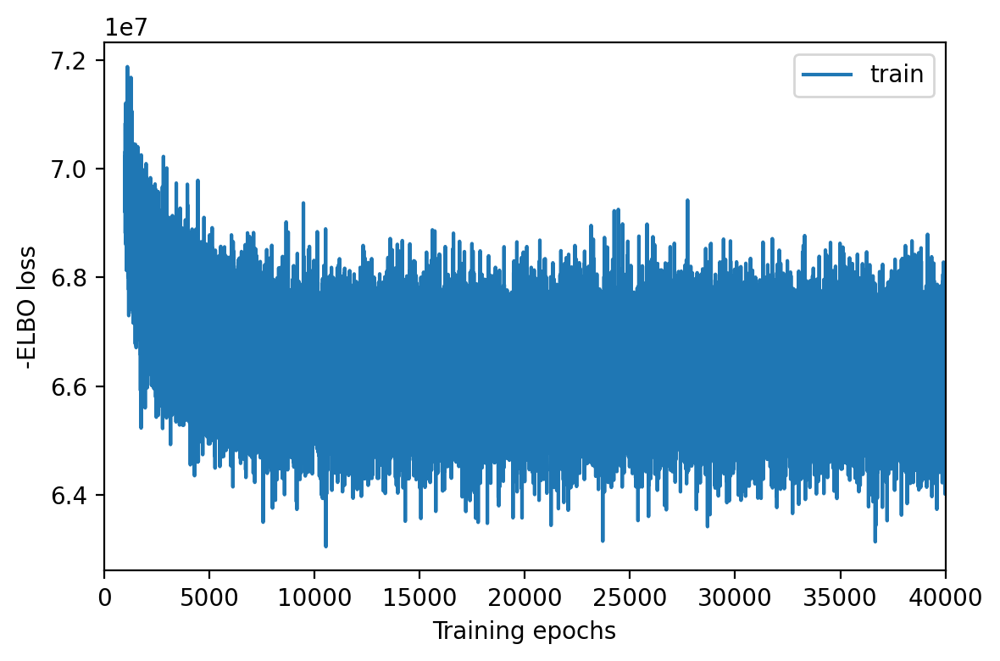

In [23]:
with mpl.rc_context({"figure.dpi": 200}):
    mod.plot_history(1000)

In [24]:
mod.save(run_name, overwrite=True)

In [8]:
mod = Cell2location.load(run_name, adata_vis, use_gpu=False)

INFO     File cell2location/mouse_model/model.pt already downloaded                          
INFO     Preparing underlying module for load                                                


GPU available: True, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
/home/kats/.local/lib/python3.10/site-packages/pytorch_lightning/trainer/trainer.py:1584: UserWarning: GPU available but not used. Set the gpus flag in your trainer `Trainer(gpus=1)` or script `--gpus=1`.
  rank_zero_warn(
/home/kats/.local/lib/python3.10/site-packages/pytorch_lightning/trainer/configuration_validator.py:120: UserWarning: You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.
  rank_zero_warn("You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.")
/home/kats/.local/lib/python3.10/site-packages/pytorch_lightning/trainer/data_loading.py:432: UserWarning: The number of training samples (1) is smaller than the logging interval Trainer(log_every_n_steps=10). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.
  rank_zero_warn(


Epoch 1/30000:   0%|                                                                                                                    | 1/30000 [00:02<22:57:17,  2.75s/it, v_num=1, elbo_train=1.27e+8]


In [25]:
adata_vis = mod.export_posterior(
    adata_vis,
    sample_kwargs={"num_samples": 10000, "batch_size": 10000, "use_gpu": True},
)
adata_vis.write_h5ad(
    os.path.join(run_name, "sp.h5ad"), compression="gzip", compression_opts=9
)

Sampling global variables, sample: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9999/9999 [02:04<00:00, 80.16it/s]


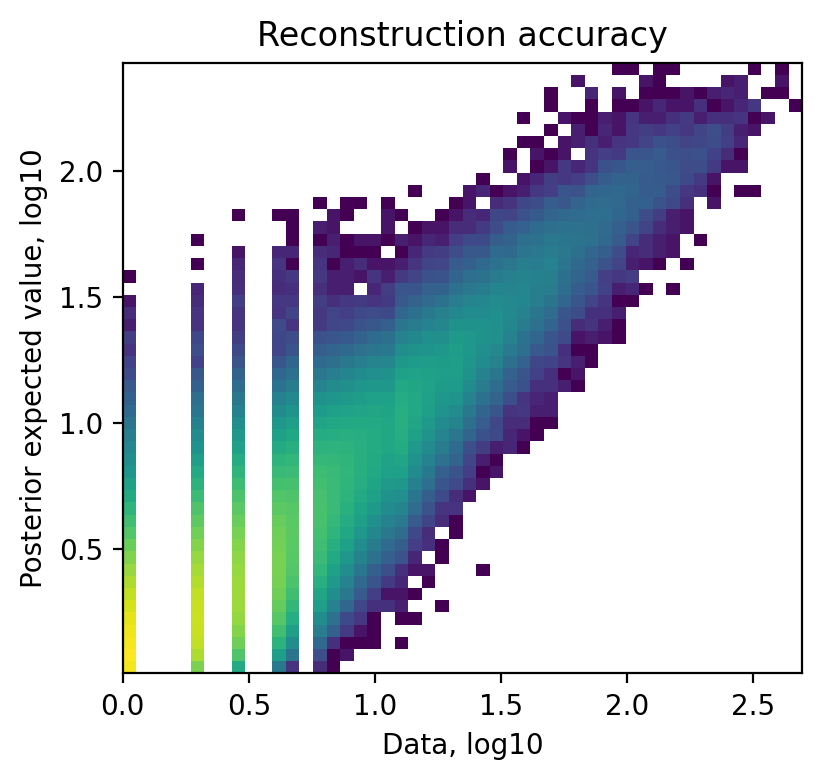

In [26]:
with mpl.rc_context({"figure.dpi": 200}):
    mod.plot_QC()

In [5]:
adata_vis = ad.read_h5ad(os.path.join(run_name, "sp.h5ad"))

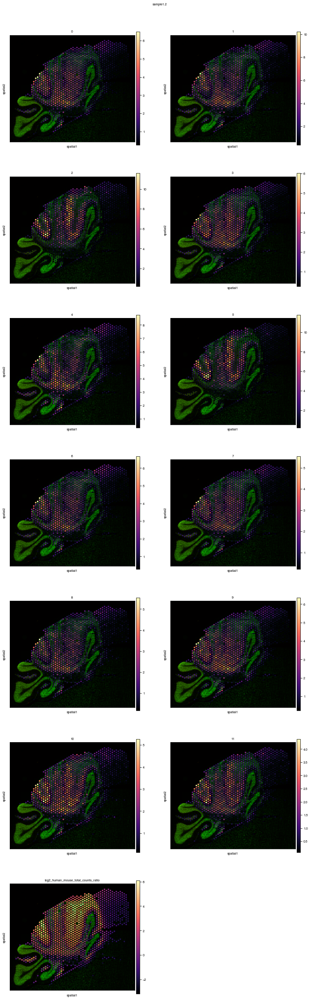

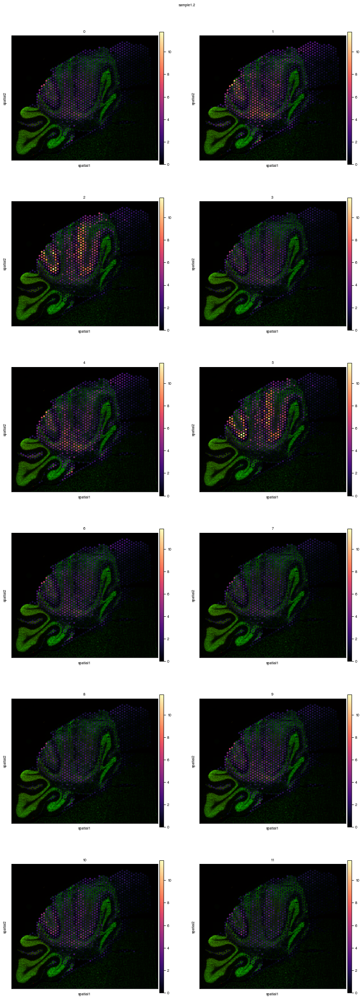

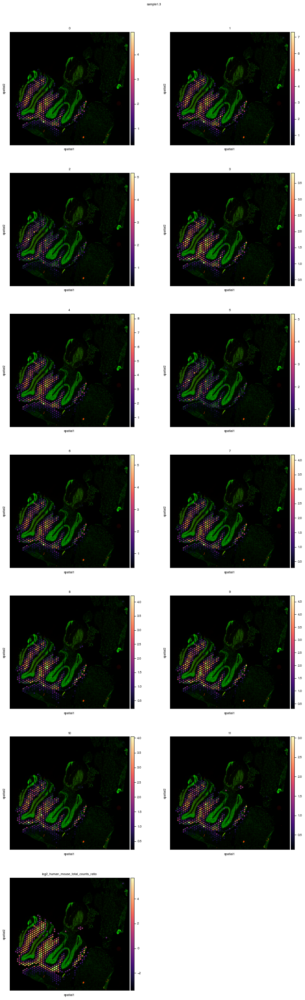

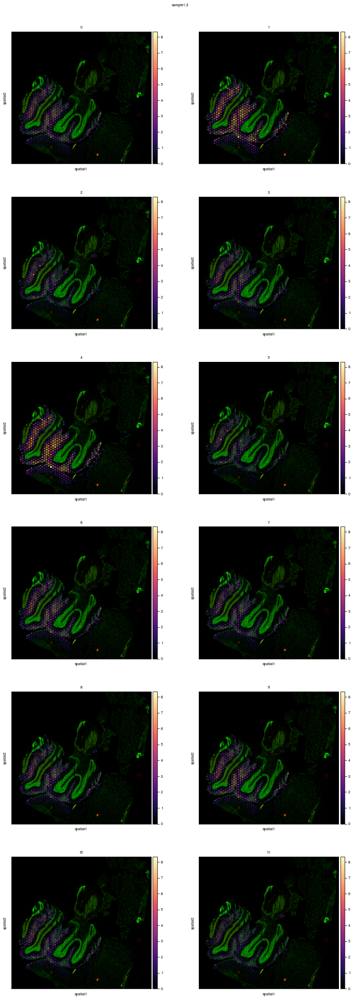

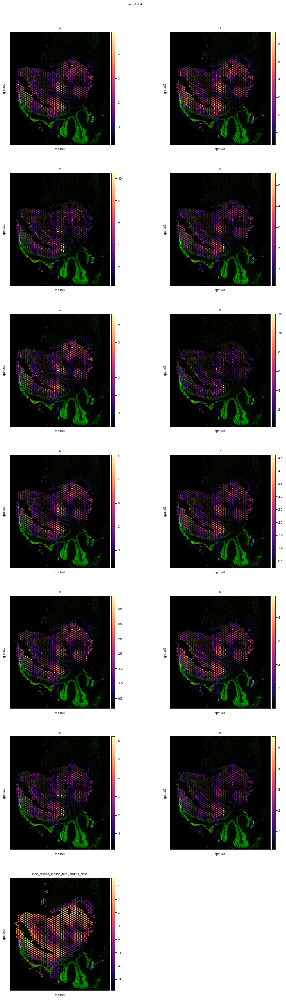

...

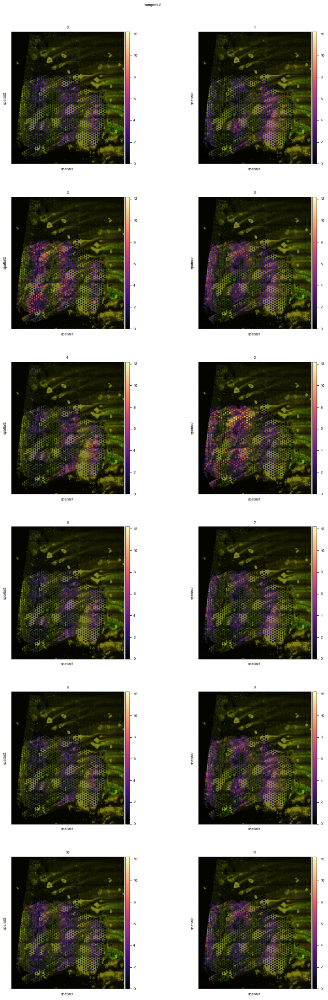

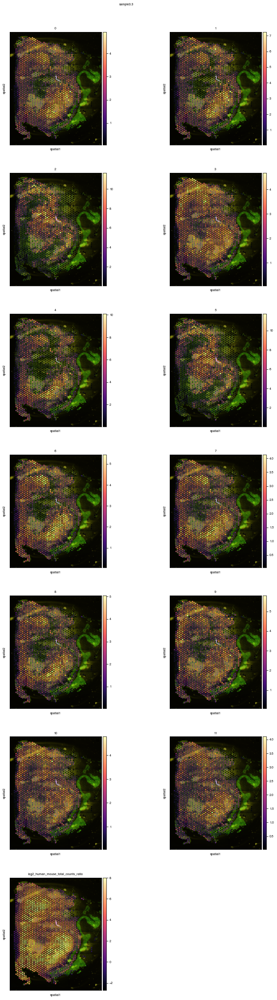

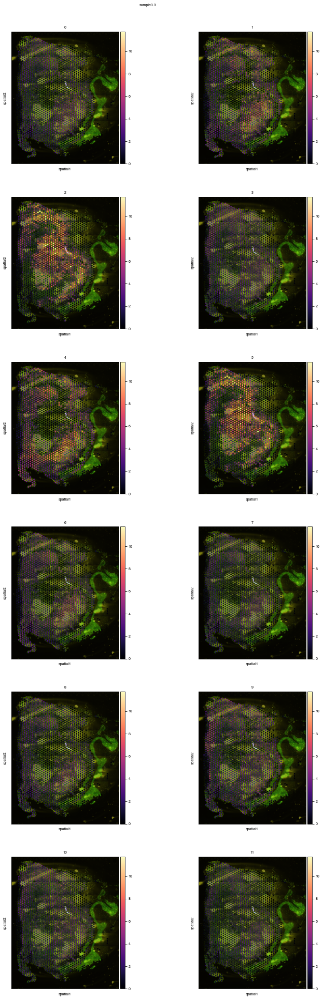

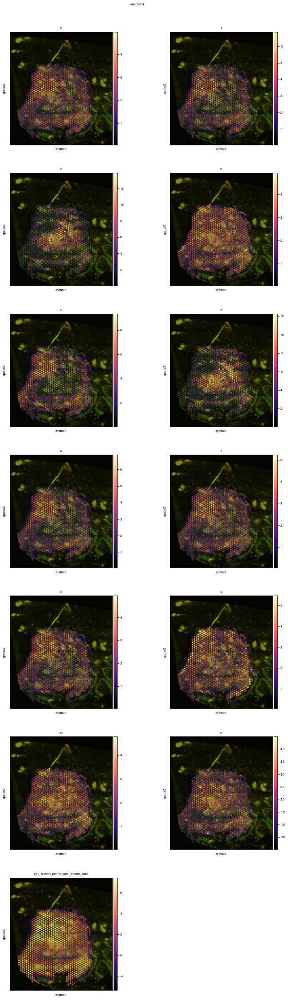

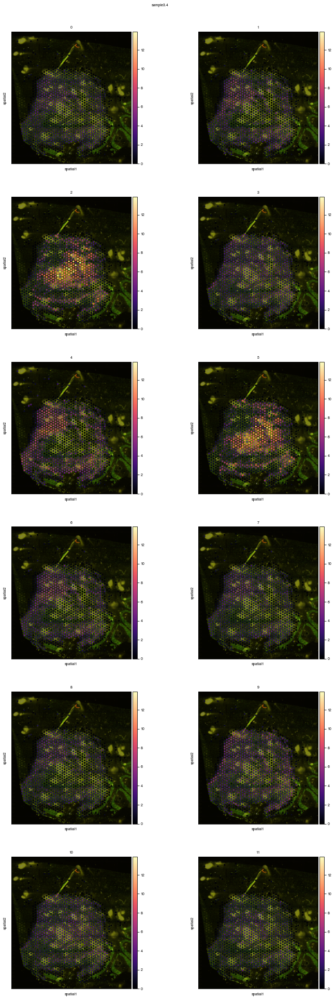

In [6]:
toplot = adata_vis.uns["mod"]["factor_names"].astype(str).tolist()
adata_vis.obs[toplot] = adata_vis.obsm["q05_cell_abundance_w_sf"]

for sample in sorted(adata_vis.uns["spatial"].keys()):
    slide = select_slide(adata_vis, sample)

    with mpl.rc_context({"figure.figsize": [5, 5]}):
        sc.pl.spatial(
            slide,
            cmap="magma",
            color=toplot + ["log2_human_mouse_total_counts_ratio"],
            ncols=2,
            show=False,
        )
        plt.suptitle(sample, y=0.9)
        plt.show()

        vmax = slide.obs[toplot].max().max()
        sc.pl.spatial(
            slide, cmap="magma", color=toplot, ncols=2, show=False, vmin=0, vmax=vmax
        )
        plt.suptitle(sample, y=0.9)
        plt.show()

In [7]:
sc.tl.pca(adata_vis)

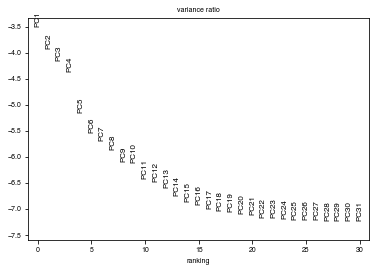

In [8]:
sc.pl.pca_variance_ratio(adata_vis, log=True)

In [9]:
sc.pp.neighbors(adata_vis, n_neighbors=15, n_pcs=20)

In [10]:
sc.tl.umap(adata_vis)

In [11]:
adata_vis.obs["treatment"] = pd.Categorical(
    adata_vis.obs["sample"].map(
        {
            "sample1.2": "control",
            "sample1.3": "carbon",
            "sample1.4": "carbon+PARPi",
            "sample2.1": "carbon",
            "sample2.2": "carbon",
            "sample2.3": "carbon",
            "sample2.4": "carbon+PARPi",
            "sample3.1": "control",
            "sample3.2": "carbon+PARPi",
            "sample3.3": "carbon+PARPi",
            "sample3.4": "carbon",
        }
    )
)

timepointmap = {
    "sample1.2": "pre-treatment",
    "sample1.3": "MRD",
    "sample1.4": "regrown",
    "sample2.1": "early effect",
    "sample2.2": "early effect",
    "sample2.3": "early effect",
    "sample2.4": "MRD",
    "sample3.1": "pre-treatment",
    "sample3.2": "regrown",
    "sample3.3": "regrown",
    "sample3.4": "regrown",
}
adata_vis.obs["timepoint_description"] = pd.Categorical(
    adata_vis.obs["sample"].map(timepointmap),
    categories=["pre-treatment", "early effect", "MRD", "small", "regrown"],
    ordered=True,
)

/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored


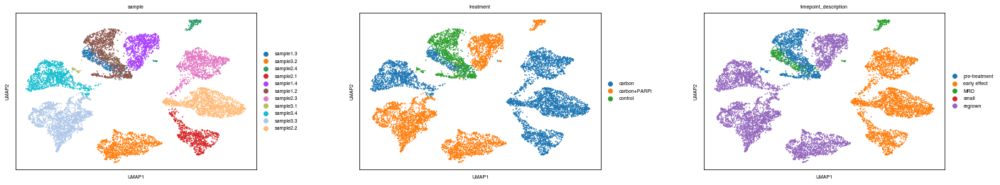

In [12]:
sc.pl.umap(
    adata_vis, color=["sample", "treatment", "timepoint_description"], wspace=0.3
)

In [84]:
from scvi.model import SCVI

SCVI.setup_anndata(adata_vis, layer="counts", batch_key="sample")
vae = SCVI(
    adata_vis, n_layers=1, n_latent=10, gene_likelihood="nb", dispersion="gene-batch"
)
vae.train(
    max_epochs=300,
    use_gpu=True,
    train_size=0.9,
    batch_size=10000,
    check_val_every_n_epoch=1,
)

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]
/home/kats/.local/lib/python3.10/site-packages/pytorch_lightning/trainer/data_loading.py:432: UserWarning: The number of training samples (1) is smaller than the logging interval Trainer(log_every_n_steps=10). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Epoch 300/300: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 300/300 [00:58<00:00,  5.14it/s, loss=6.98e+03, v_num=1]


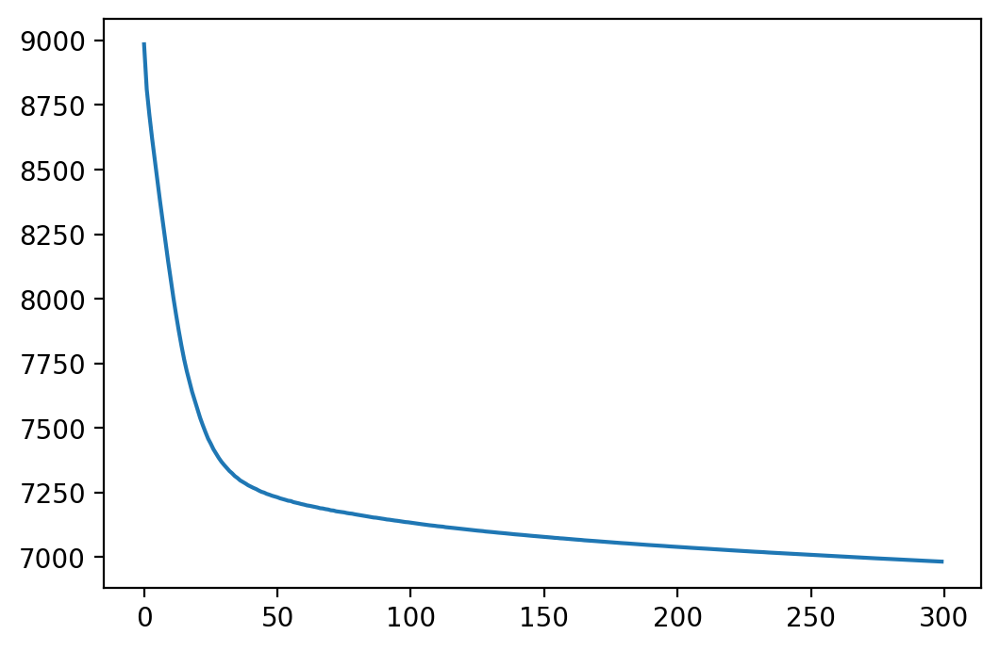

In [85]:
with mpl.rc_context({"figure.dpi": 200}):
    plt.plot(vae.history["elbo_train"])

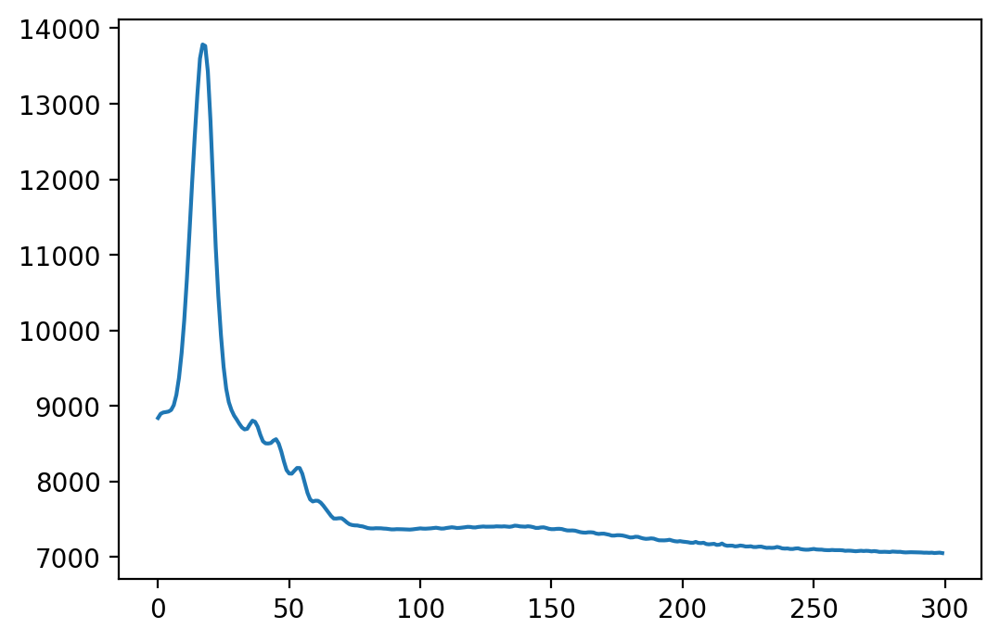

In [86]:
with mpl.rc_context({"figure.dpi": 200}):
    plt.plot(vae.history["elbo_validation"])

In [ ]:
adata_vis.obsm["X_scVI"] = vae.get_latent_representation()
sc.pp.neighbors(adata_vis, use_rep="X_scVI", n_neighbors=20, key_added="neighbors_scVI")
adata_vis.obsm["X_umap_scVI"] = sc.tl.umap(
    adata_vis, neighbors_key="neighbors_scVI", copy=True
).obsm["X_umap"]

/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored


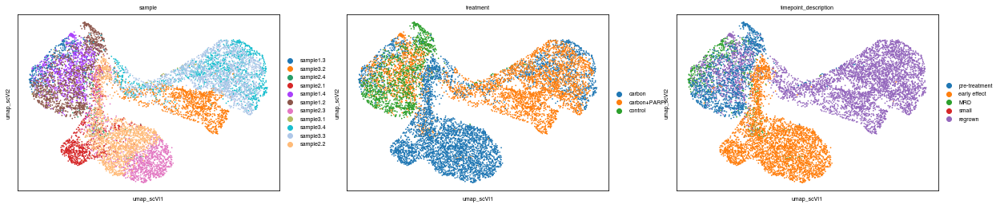

In [13]:
sc.pl.embedding(
    adata_vis,
    basis="umap_scVI",
    color=["sample", "treatment", "timepoint_description"],
)

In [89]:
adata_vis.write_h5ad(os.path.join(run_name, "sp.h5ad", compression="gzip", compression_opts=9)

In [14]:
adata_vis.obs["dominant_region_celltype"] = pd.Categorical(
    np.asarray(adata_vis.uns["mod"]["factor_names"])[
        adata_vis.obsm["q05_cell_abundance_w_sf"].to_numpy().argmax(1)
    ].astype(str)
)

In [15]:
celltypecloneorder = ["0", "3", "4", "5", "9", "1", "2", "6", "7"]
celltypeclonepalette = {
    0: "#1f77b4",
    1: "#2cabff",
    2: "#2937ff",
    3: "#259ba1",
    4: "#30d1fd",
    5: "#ff7f0e",
    6: "#ffbe26",
    7: "#b03010",
    8: "#ee3a1a"
}

In [16]:
adata_vis = adata_vis[adata_vis.obs.dominant_region_celltype.isin(celltypecloneorder)]
adata_vis.obs.dominant_region_celltype = (
    adata_vis.obs.dominant_region_celltype.cat.rename_categories(
        {k: i for i, k in enumerate(celltypecloneorder)}
    )
)
adata_vis.obs.dominant_region_celltype = (
    adata_vis.obs.dominant_region_celltype.cat.reorder_categories(
        adata_vis.obs.dominant_region_celltype.cat.categories.sort_values()
    )
)

/home/kats/.local/lib/python3.10/site-packages/pandas/core/generic.py:5936: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.


/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
/home/kats/.local/lib/python3.10/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored


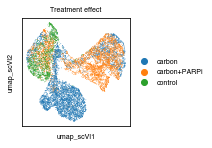

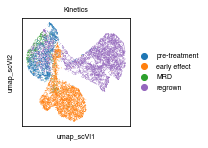

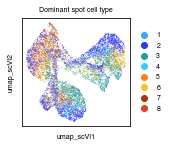

In [17]:
with mpl.rc_context({"figure.figsize": (4, 2)}):
    for var, title in zip(
        ("treatment", "timepoint_description"), ("Treatment effect", "Kinetics")
    ):
        sc.pl.embedding(
            adata_vis,
            basis="umap_scVI",
            color=var,
            title=title,
            size=2,
            wspace=2,
            show=False,
        )
        plt.gca().set_box_aspect(1)
        plt.savefig(f"figures/7_umap_{var}.svgz")

    sc.pl.embedding(
        adata_vis[adata_vis.obs.dominant_region_celltype.astype(int) <= 9],
        basis="umap_scVI",
        color="dominant_region_celltype",
        palette=celltypeclonepalette,
        title="Dominant spot cell type",
        size=2,
        wspace=2,
        show=False,
    )
    plt.gca().set_box_aspect(1)
    plt.savefig("figures/7B.svgz")

/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: In a future version of pandas all arguments of Categorical.replace except for the argument 'value' will be keyword-only.
/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored


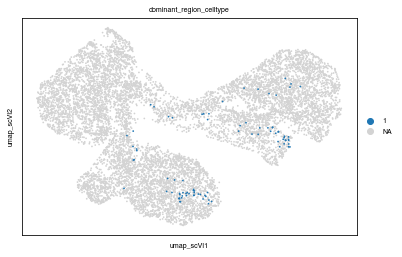

/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: In a future version of pandas all arguments of Categorical.replace except for the argument 'value' will be keyword-only.
/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored


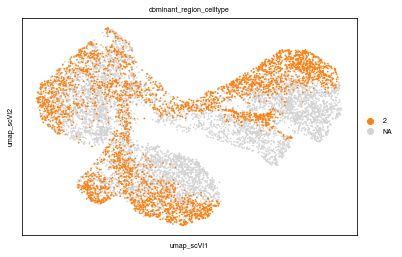

/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: In a future version of pandas all arguments of Categorical.replace except for the argument 'value' will be keyword-only.
/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored


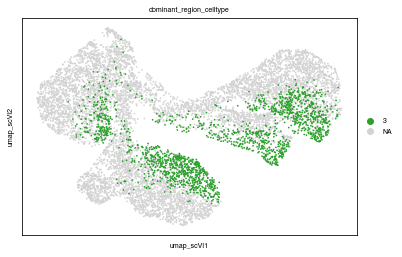

/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: In a future version of pandas all arguments of Categorical.replace except for the argument 'value' will be keyword-only.
/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored


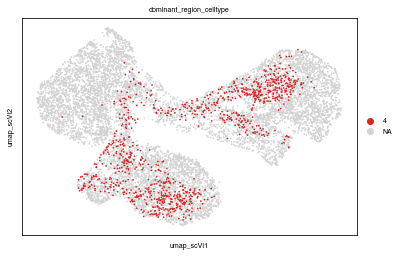

/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: In a future version of pandas all arguments of Categorical.replace except for the argument 'value' will be keyword-only.
/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored


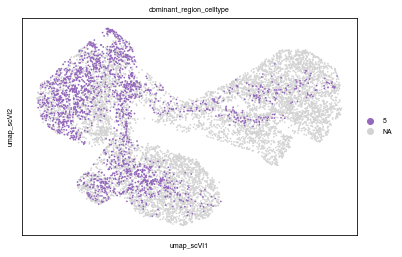

/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: In a future version of pandas all arguments of Categorical.replace except for the argument 'value' will be keyword-only.
/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored


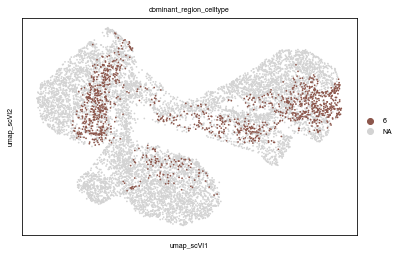

/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: In a future version of pandas all arguments of Categorical.replace except for the argument 'value' will be keyword-only.
/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored


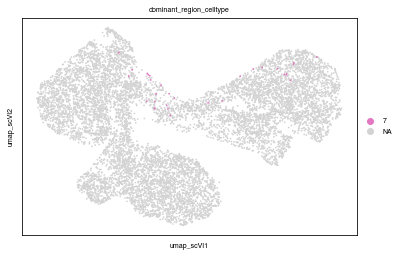

/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: In a future version of pandas all arguments of Categorical.replace except for the argument 'value' will be keyword-only.
/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored


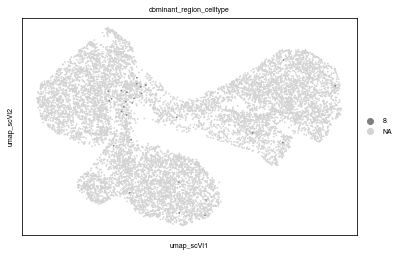

In [18]:
for cg in adata_vis.obs.dominant_region_celltype.cat.categories:
    sc.pl.embedding(adata_vis, basis="umap_scVI", color="dominant_region_celltype", groups=[cg])

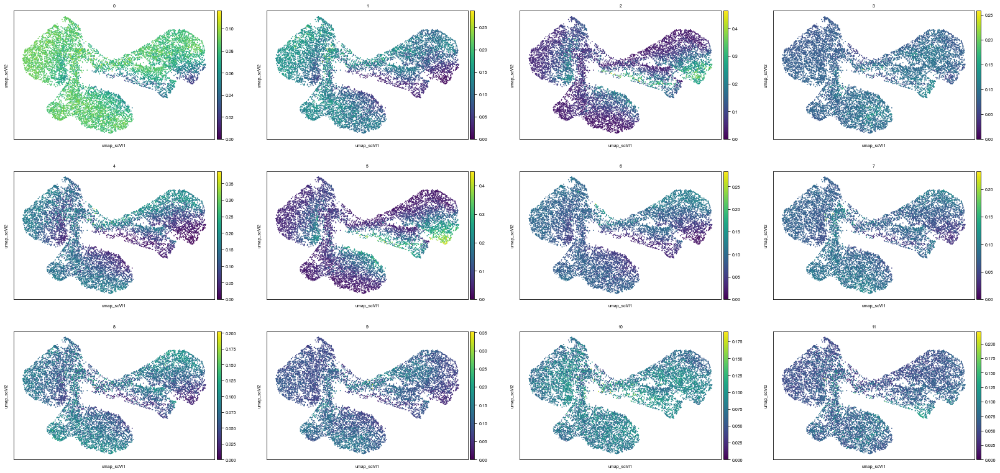

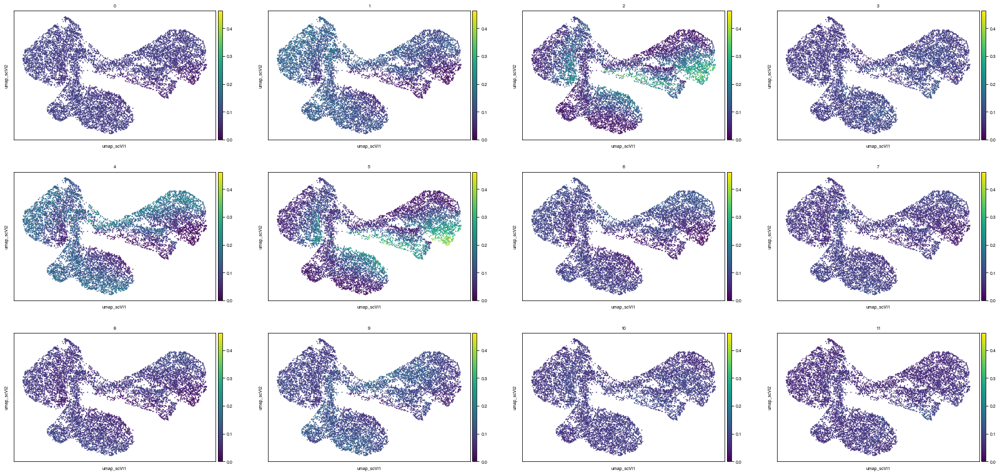

In [19]:
adata_vis.obs[toplot] = adata_vis.obsm["q05_cell_abundance_w_sf"].div(adata_vis.obsm["q05_cell_abundance_w_sf"].sum(1), axis=0)
sc.pl.embedding(adata_vis, basis="umap_scVI", color=toplot, vmin=0)
sc.pl.embedding(adata_vis, basis="umap_scVI", color=toplot, vmin=0, vmax=adata_vis.obs[toplot].max().max())

/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:718: PlotnineWarning: Saving 8 x 1.95 in image.
/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Filename: figures/7C.svgz
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:694: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python

/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:694: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[

/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:694: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[

/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:694: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[

/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:694: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[

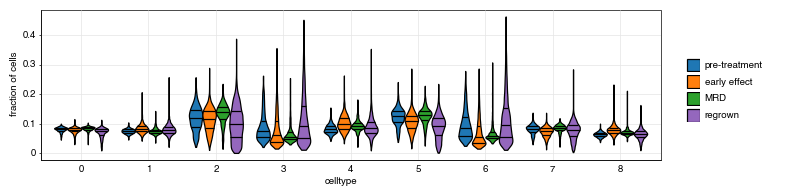

In [20]:
p = (
    ggplot(
        adata_vis.obsm["q05_cell_abundance_w_sf"]
        .div(adata_vis.obsm["q05_cell_abundance_w_sf"].sum(1), axis=0)
        .rename(columns=lambda x: x[23:])
        .loc[:, celltypecloneorder]
        .rename(columns={k: i for i, k in enumerate(celltypecloneorder)})
        .assign(timepoint_description=adata_vis.obs.timepoint_description)
        .melt(
            id_vars="timepoint_description", var_name="celltype", value_name="fraction"
        )
        .assign(
            celltype=lambda x: pd.Categorical(
                x.celltype.astype(int),
                categories=np.arange(len(celltypecloneorder)),
            )
        )
        .assign(
            group=lambda x: pd.Categorical(
                x.celltype.astype(str) + x.timepoint_description.astype(str),
                categories=np.dstack(
                    np.meshgrid(
                        x.celltype.cat.categories.astype(str),
                        x.timepoint_description.cat.categories,
                        indexing="ij",
                    )
                )
                .reshape((-1, 2))
                .sum(1),
            )
        ),
        aes("celltype", "fraction", fill="timepoint_description", group="group"),
    )
    + geom_violin(
        scale="width",
        color="black",
        n=4096,
        width=0.8,
        draw_quantiles=[0.25, 0.5, 0.75],
    )
    + scale_fill_manual(
        breaks=adata_vis.obs.timepoint_description.cat.categories,
        values=adata_vis.uns["timepoint_description_colors"],
    )
    + guides(color=guide_legend(override_aes={"size": 3, "alpha": 1}))
    + labs(y="fraction of cells", fill="")
    + theme(aspect_ratio="auto", figure_size=(8, 1.95), axis_ticks_major_x=element_blank())
)
p.save("figures/7C.svgz")
print(p)

In [21]:
adata = adata_ref[adata_ref.obs.segmentation_labels.astype(str).isin(celltypecloneorder)]
adata.obs.segmentation_labels = (
    adata.obs.segmentation_labels.cat.rename_categories(
        {int(k): i for i, k in enumerate(celltypecloneorder)}
    )
)
adata.obs.segmentation_labels = (
    adata.obs.segmentation_labels.cat.reorder_categories(
        adata.obs.segmentation_labels.cat.categories.sort_values()
    )
)

/home/kats/.local/lib/python3.10/site-packages/pandas/core/generic.py:5936: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.


In [22]:
catmap = {
    0: "0: Inflammation",
    5: "5: Proliferation",
    6: "6: Neuronal differentiation 1",
    1: "1: Proliferation and migration",
    2: "2: Malignant (resistant)",
    3: "3: Neuronal differentiation 2",
    7: "7: Immune infiltration",
    8: "8: Vasculature, extracellular matrix",
    4: "4: Oxidative stress response, metabolism",
}

adata.obs[
    "segmentation_labels_names"
] = adata.obs.segmentation_labels.cat.rename_categories(catmap)
celltypenameclonepalette = {v: celltypeclonepalette[int(k)] for k, v in catmap.items()}

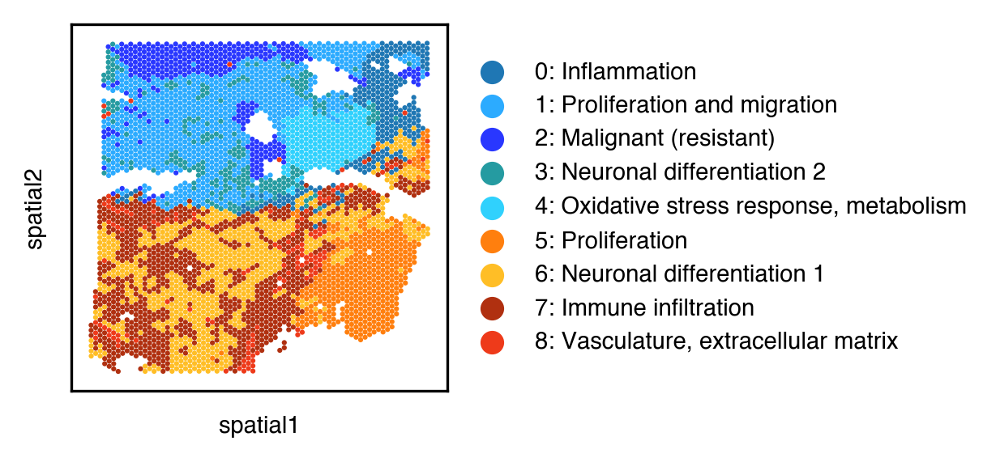

In [23]:
with mpl.rc_context({"figure.figsize": (6, 2), "figure.dpi": 300}):
    sc.pl.spatial(
        adata,
        color="segmentation_labels_names",
        img_key=None,
        size=1.5,
        palette=celltypenameclonepalette,
        title="",
        show=False
    )
    plt.savefig("figures/7A.svgz")
    plt.show()

/home/kats/.local/lib/python3.10/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
/home/kats/.local/lib/python3.10/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
/home/kats/.local/lib/python3.10/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
/home/kats/.local/lib/python3.10/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.


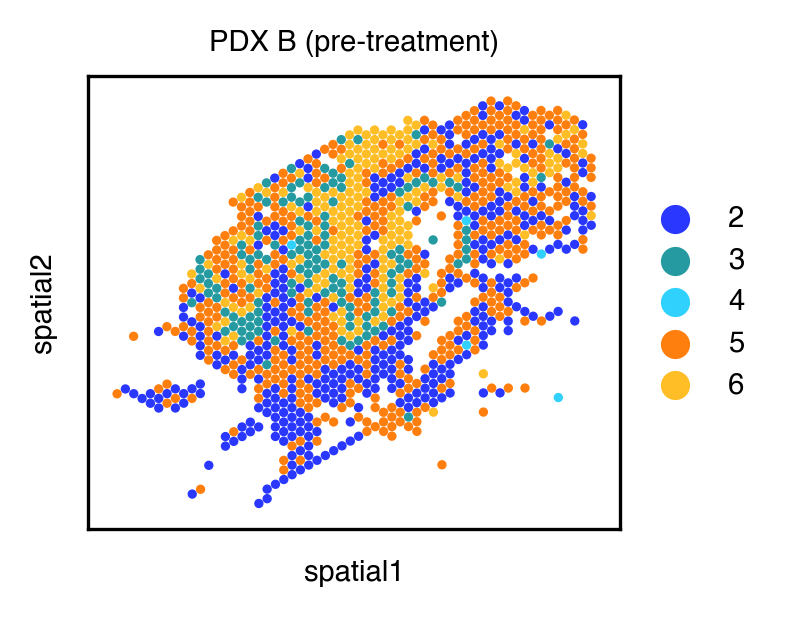

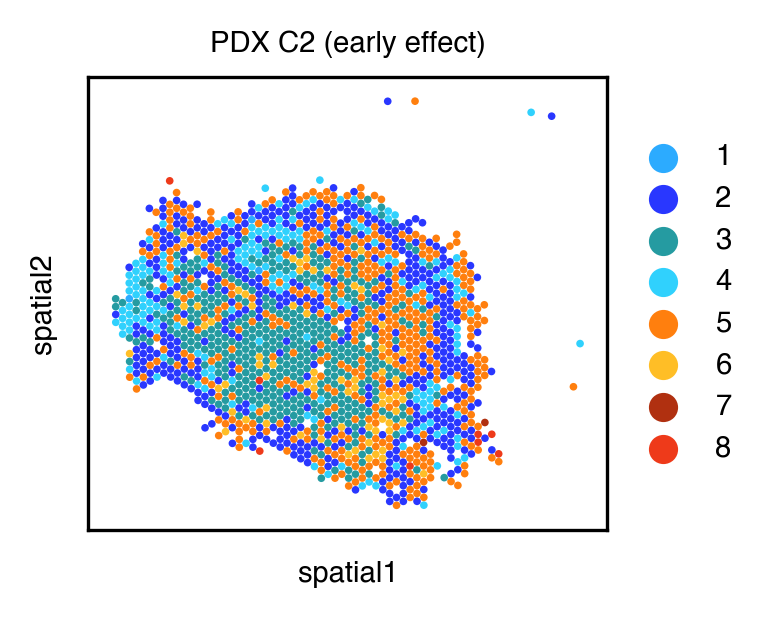

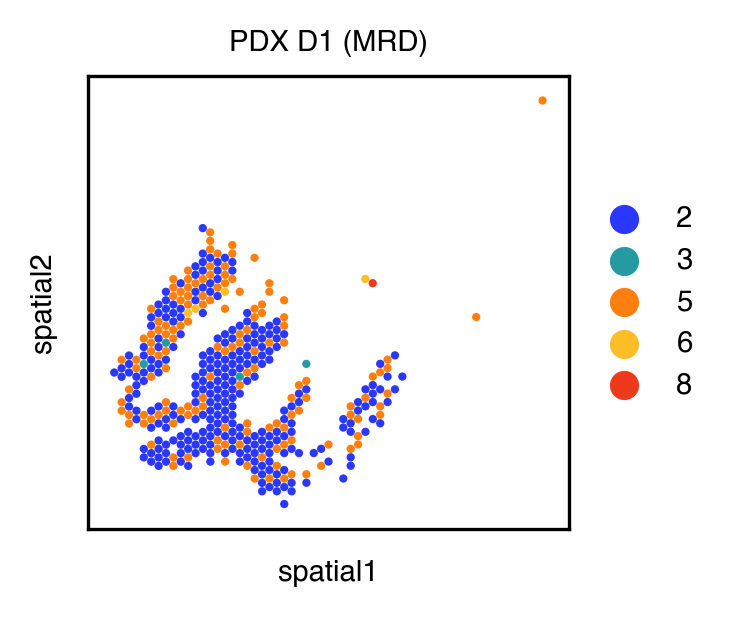

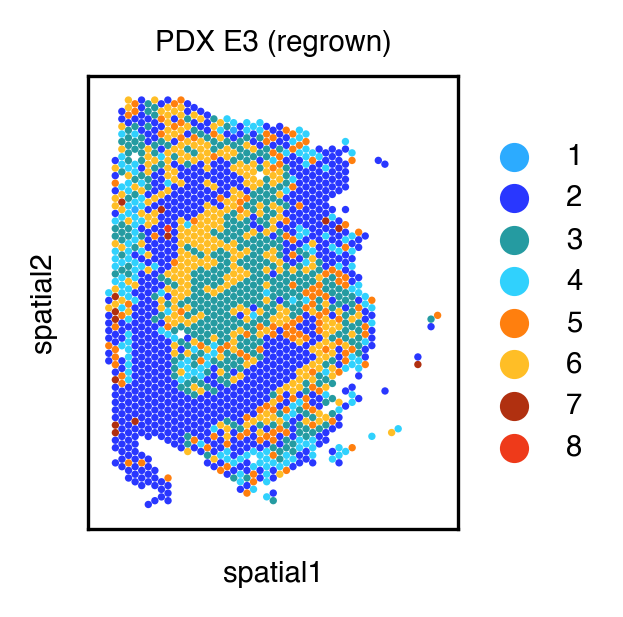

In [24]:
with mpl.rc_context({"figure.figsize": (6, 2), "figure.dpi": 300}):
    for sample in ("1.2", "2.2", "1.3", "3.3"):
        slide = select_slide(adata_vis, "sample" + sample)
        slide = slide[
            slide.obs.dominant_region_celltype.isin(celltypeclonepalette.keys())
        ]

        sc.pl.spatial(
            slide,
            title=f"{pdx_sample_map[sample]} ({timepointmap['sample' + sample]})",
            color="dominant_region_celltype",
            palette=celltypeclonepalette,
            img_key=None,
            size=1.5,
            show=False,
        )
        plt.savefig(f"figures/7D_{sample}.svgz")